# Problem Statement

Buying a house is the largest single investment the average person will make in their life.
Knowing the future prices and when to buy a property are crucial for minimizing the amount of
leverage a buyer will need in the form of a mortgage. With the average buyer not having an indepth knowledge of real estate, buyers can potentially overpay for a property. Further, market
volatility is alarming to buyers, who may not fully follow every single macroeconomic driver
affecting housing. All these monetary uncertainties place large volumes of stress on families
and investors, leading to a reduced quality of life. The core question that this paper will look to
answer is: How can macroeconomic factors and historical housing data be leveraged to
accurately predict future house prices in Sydney's largest LGAs?

# Objective

The objective of this project is to generate a model that can accurately predict house prices in
the ten largest LGAs in Sydney. This model will be created by training it on historical median
house prices and macroeconomic indicators, including inflation, unemployment and interest
rates. Inputting these datapoints into the model will help to calculate future prices, avoiding
market participant overpay. When this model is deployed into the real world, the inputs will be
the newly published macro-economic data points, which will be used to predict the median
house prices in the ten largest LGAs by population. Creating a house price prediction model will
help buyers and sellers be less anxious about the future value of their properties, as well as be
able to avoid overpaying for a property and maximizing their returns.

# Connect to drive and check Directory

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [2]:
%cd /content/gdrive/MyDrive/Year 3 Uni/31005 ML

/content/gdrive/MyDrive/Year 3 Uni/31005 ML


In [3]:
!ls

 24505012_A2_ProjectJournal.pdf   house_data.csv		   logs
'ABS Data.csv'			  House_data.xlsx		   second_nn.h5
'AT3 Script.docx'		  HousePredictor.ipynb		   second_nn.keras
 first_nn.h5			  HousePredictorReport.docx	   SemesterNotes.docx
 first_nn.keras			  HousePricePredictorPrezzo.pptx
 GraderSheet_P4_24505012.xlsx	 'LGA Data.xlsx'


## Import necessary libraries

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
sns.set_theme(rc={"figure.dpi":120, 'savefig.dpi':120})

# sklearn
import sklearn as sk
from sklearn import *
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import *
# SVM
from sklearn.svm import SVC

# House Data

In [5]:
HD = pd.read_csv('house_data.csv')
HD = HD.drop(columns=['Unnamed: 42', 'Unnamed: 43', 'Unnamed: 44', 'Unnamed: 45'])
HD

,Month,Retail_trade_($m),GDP_bil,GDP_growth(%),RBA_cash_rate,CPI_Quarter_Chg,CPI_Annual_Chg,Unemployent_rate_%,Household_spending_month_ann_chg,Household_spending_NSW_ann_chg,...,LIVERPOOL CITY COUNCIL (LGA) (House)_num,LIVERPOOL CITY COUNCIL (LGA) (House)_price,FAIRFIELD CITY COUNCIL (LGA) (House)_num,FAIRFIELD CITY COUNCIL (LGA) (House)_price,PENRITH CITY COUNCIL (LGA) (House)_num,PENRITH CITY COUNCIL (LGA) (House)_price,INNER WEST COUNCIL(LGA) (House)_num,INNER WEST COUNCIL(LGA) (House)_price,Total_10_num,Total_10_val
0,Sep-84,4212.2,158.151,0.9,12.13,1.4,3.7,8.7,6.11,5.48,...,82,57250,168,61750.0,207,53500,99,68000,1711,832735.0
1,Oct-84,4241.5,158.151,0.9,12.75,1.4,3.7,8.7,6.86,5.21,...,82,57250,168,61750.0,207,53500,99,68000,1711,832735.0
2,Nov-84,4271.0,158.151,0.9,11.13,1.4,3.7,8.7,7.62,6.65,...,82,57250,168,61750.0,207,53500,99,68000,1711,832735.0
3,Dec-84,4303.1,159.248,0.7,11.25,1.4,2.5,8.5,7.07,6.27,...,70,57000,192,59062.5,211,59500,109,72000,1982,1049062.5
4,Jan-85,4339.8,159.248,0.7,11.88,1.4,2.5,8.6,7.47,8.95,...,70,57000,192,59062.5,211,59500,109,72000,1982,1049062.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
473,Feb-24,35859.1,609.500,0.3,4.35,0.6,4.1,3.7,5.92,7.37,...,581,1050000,414,1100000.0,580,930750,433,2100000,6724,14176478.0
474,Mar-24,35722.3,610.300,0.1,4.35,1.0,3.6,3.9,3.75,1.87,...,525,1015000,330,1161500.0,557,962000,376,2202500,6075,14500000.0
475,Apr-24,35809.5,610.300,0.1,4.35,1.0,3.6,4.1,3.90,3.29,...,525,1015000,330,1161500.0,557,962000,376,2202500,6075,14500000.0
476,May-24,36014.3,610.300,0.1,4.35,1.0,3.6,4.0,4.87,4.07,...,525,1015000,330,1161500.0,557,962000,376,2202500,6075,14500000.0


# Visualisations

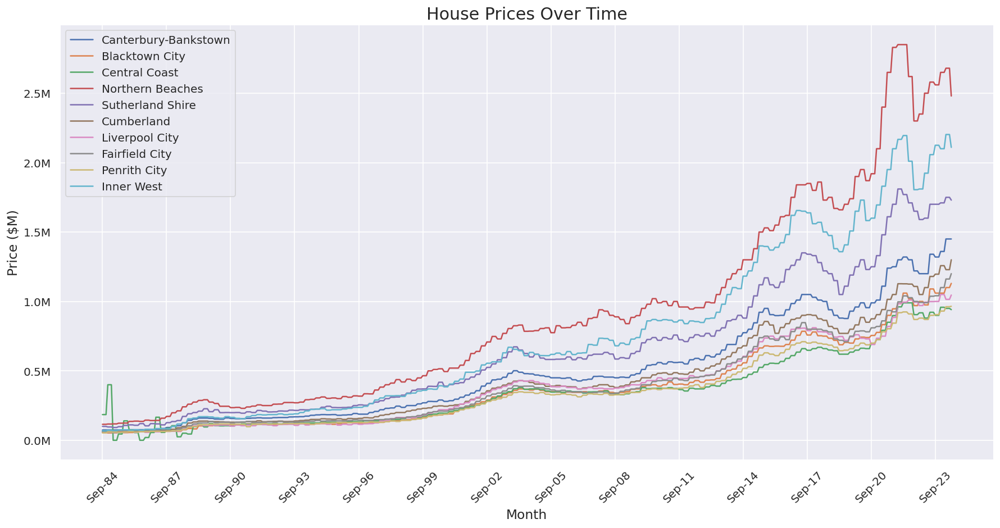

In [6]:
from matplotlib.ticker import FuncFormatter
target = [
    'CANTERBURY-BANKSTOWN COUNCIL(LGA) (House)_price',
    'BLACKTOWN CITY COUNCIL (LGA) (House)_price',
    'CENTRAL COAST COUNCIL(LGA) (House)_price',
    'NORTHERN BEACHES COUNCIL(LGA) (House)_price',
    'SUTHERLAND SHIRE COUNCIL (LGA) (House)_price',
    'CUMBERLAND COUNCIL(LGA) (House)_price',
    'LIVERPOOL CITY COUNCIL (LGA) (House)_price',
    'FAIRFIELD CITY COUNCIL (LGA) (House)_price',
    'PENRITH CITY COUNCIL (LGA) (House)_price',
    'INNER WEST COUNCIL(LGA) (House)_price'
]

custom_labels = [
    'Canterbury-Bankstown',
    'Blacktown City',
    'Central Coast',
    'Northern Beaches',
    'Sutherland Shire',
    'Cumberland',
    'Liverpool City',
    'Fairfield City',
    'Penrith City',
    'Inner West'
]

def plot_target_values(df, target_list, labels, x_label_frequency=36):
    plt.figure(figsize=(15, 8))

    for col, label in zip(target_list, labels):
        plt.plot(df['Month'], df[col], label=label)

    plt.title('House Prices Over Time', fontsize=18)
    plt.xlabel('Month', fontsize=14)
    plt.ylabel('Price ($M)', fontsize=14)

    plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{x * 1e-6:.1f}M'))

    plt.legend(fontsize=12)

    plt.xticks(df['Month'][::x_label_frequency], rotation=45, fontsize=12)
    plt.yticks(fontsize=12)

    plt.tight_layout()
    plt.show()

plot_target_values(HD, target, custom_labels)

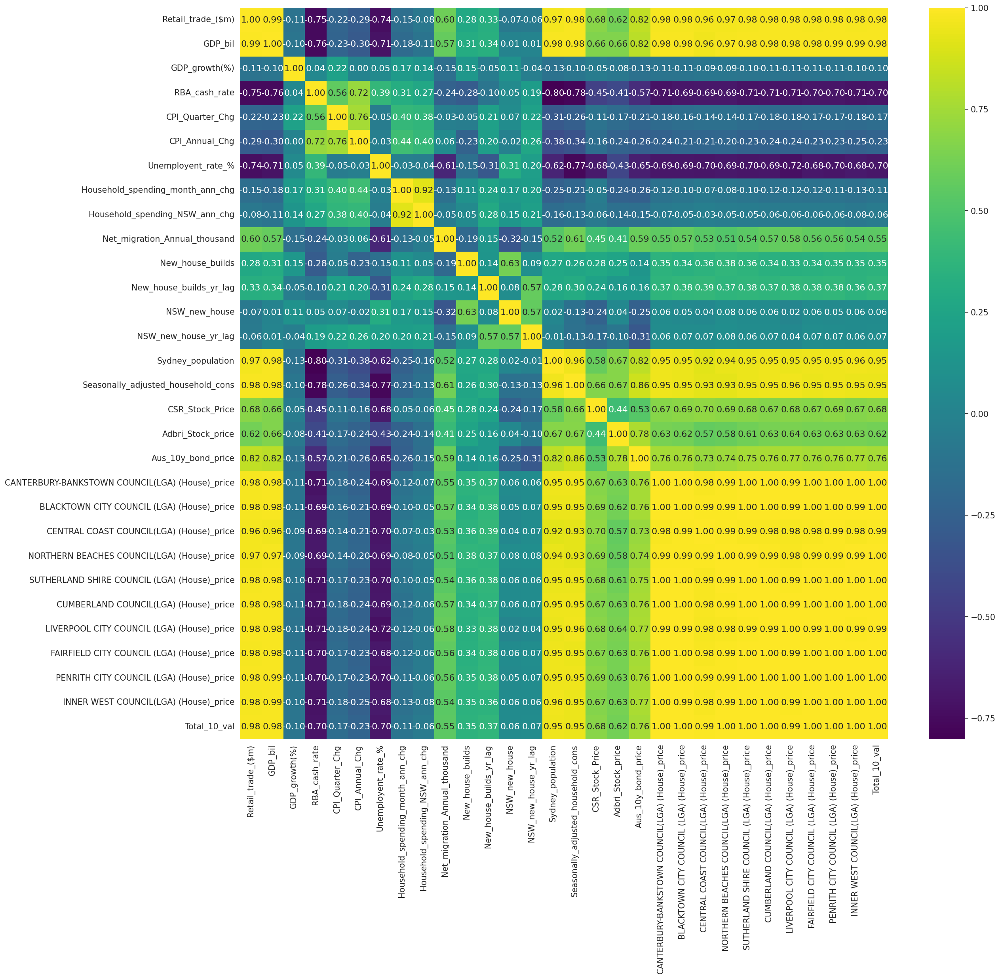

In [7]:
columns_to_drop = [
    'Month',
    'CANTERBURY-BANKSTOWN COUNCIL(LGA) (House)_num',
    'BLACKTOWN CITY COUNCIL (LGA) (House)_num',
    'CENTRAL COAST COUNCIL(LGA) (House)_num',
    'NORTHERN BEACHES COUNCIL(LGA) (House)_num',
    'SUTHERLAND SHIRE COUNCIL (LGA) (House)_num',
    'CUMBERLAND COUNCIL(LGA) (House)_num',
    'LIVERPOOL CITY COUNCIL (LGA) (House)_num',
    'FAIRFIELD CITY COUNCIL (LGA) (House)_num',
    'PENRITH CITY COUNCIL (LGA) (House)_num',
    'INNER WEST COUNCIL(LGA) (House)_num',
    'Total_10_num'
]
HD_cleaned = HD.drop(columns=columns_to_drop, errors='ignore')
correlation = HD_cleaned.corr()
plt.figure(figsize=(22, 20))
sns.set_context('paper', font_scale=1.4)
sns.heatmap(correlation, annot=True, cmap='viridis', fmt='.2f')
plt.show()

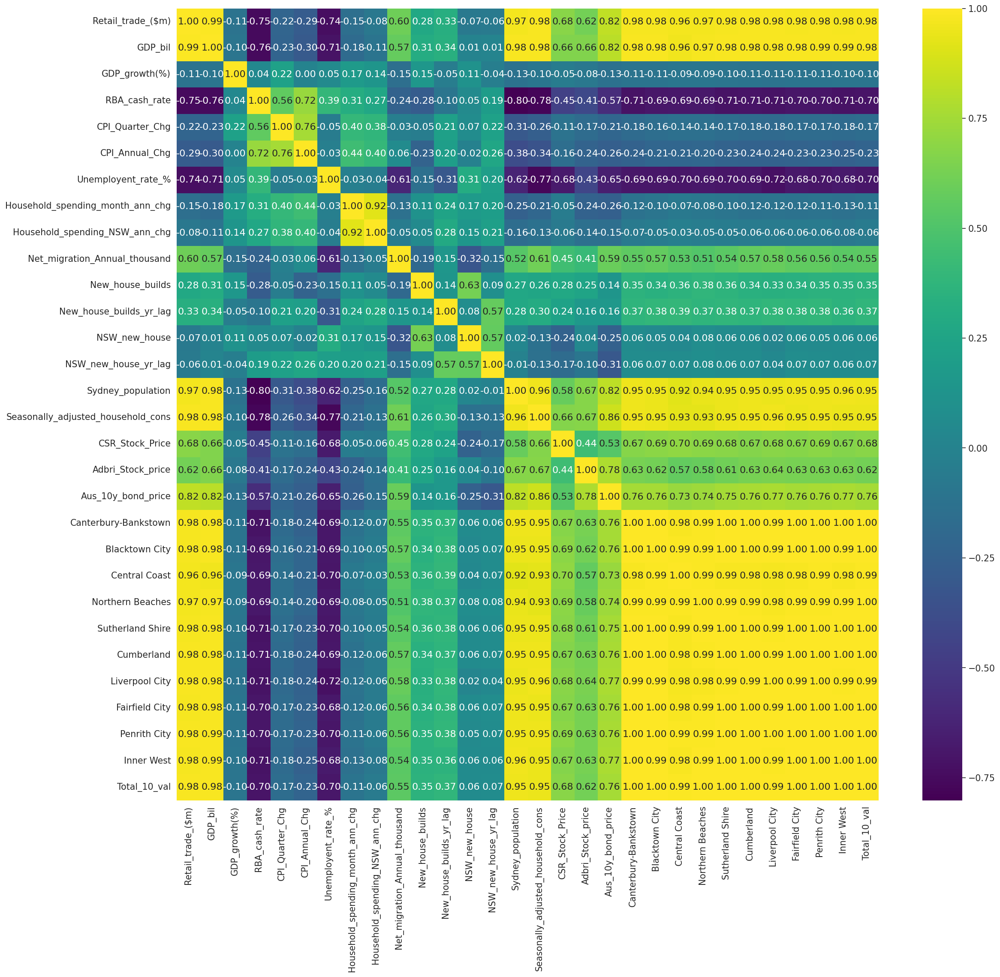

In [8]:
# Create a dictionary that maps the target columns to custom labels
rename_dict = dict(zip(target, custom_labels))

# Drop the unnecessary columns as you've already done
HD_cleaned = HD.drop(columns=columns_to_drop, errors='ignore')

# Rename the target columns using the dictionary
HD_cleaned.rename(columns=rename_dict, inplace=True)

# Now compute the correlation matrix and plot the heatmap
correlation = HD_cleaned.corr()

plt.figure(figsize=(22, 20))
sns.set_context('paper', font_scale=1.4)
sns.heatmap(correlation, annot=True, cmap='viridis', fmt='.2f')
plt.show()

# Neural Network

In [9]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.model_selection import train_test_split
import numpy as np

In [10]:
from sklearn.model_selection import train_test_split
# These are attributes that were seen as unnecessary - LSTM Model would require temporal references, but was not necessary.
dc = ['Month',
    'CANTERBURY-BANKSTOWN COUNCIL(LGA) (House)_num',
    'BLACKTOWN CITY COUNCIL (LGA) (House)_num',
    'CENTRAL COAST COUNCIL(LGA) (House)_num',
    'NORTHERN BEACHES COUNCIL(LGA) (House)_num',
    'SUTHERLAND SHIRE COUNCIL (LGA) (House)_num',
    'CUMBERLAND COUNCIL(LGA) (House)_num',
    'LIVERPOOL CITY COUNCIL (LGA) (House)_num',
    'FAIRFIELD CITY COUNCIL (LGA) (House)_num',
    'PENRITH CITY COUNCIL (LGA) (House)_num',
    'INNER WEST COUNCIL(LGA) (House)_num',
    'Total_10_num', 'Total_10_val'
]
HD_RNN = HD.drop(columns=dc, errors='ignore')
x = HD_RNN.drop(columns=target, axis=1)
y = HD_RNN[target]
xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size=0.20, random_state=42)

In [11]:
xtrain.isna().sum()

,0
Retail_trade_($m),0
GDP_bil,0
GDP_growth(%),0
RBA_cash_rate,0
CPI_Quarter_Chg,0
CPI_Annual_Chg,0
Unemployent_rate_%,0
Household_spending_month_ann_chg,0
Household_spending_NSW_ann_chg,0
Net_migration_Annual_thousand,0


In [12]:
xtest.columns

Index(['Retail_trade_($m)', 'GDP_bil', 'GDP_growth(%)', 'RBA_cash_rate',
       'CPI_Quarter_Chg', 'CPI_Annual_Chg', 'Unemployent_rate_%',
       'Household_spending_month_ann_chg', 'Household_spending_NSW_ann_chg',
       'Net_migration_Annual_thousand', 'New_house_builds',
       'New_house_builds_yr_lag', 'NSW_new_house', 'NSW_new_house_yr_lag',
       'Sydney_population', 'Seasonally_adjusted_household_cons',
       'CSR_Stock_Price', 'Adbri_Stock_price', 'Aus_10y_bond_price'],
      dtype='object')

In [13]:
print(xtrain.shape)
print(ytrain.shape)
print(xtest.shape)
print(ytest.shape)

(382, 19)
(382, 10)
(96, 19)
(96, 10)


In [14]:
sequence_length = xtrain.shape[0]  # Length of each input sequence
num_features = xtrain.shape[1]     # Number of features for each time step
num_outputs = 10                 # Number of output features

# Define the model
model = keras.Sequential([
    layers.Input(shape=(num_features,)),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(256, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(64, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(32, activation='relu'),
    layers.Dense(num_outputs)
])

In [15]:
optimizer = keras.optimizers.Adam(learning_rate=0.001, clipvalue=1.0)
model.compile(optimizer=optimizer, loss='mean_squared_error')

In [16]:
!pip install tensorboard

In [17]:
import tensorflow as tf
from tensorflow.keras.callbacks import TensorBoard
import datetime

# Create a log directory for TensorBoard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

history = model.fit(
    xtrain,
    ytrain,
    epochs=100,
    batch_size=32,
    validation_data=(xtest, ytest),
    callbacks=[tensorboard_callback]
)

Epoch 1/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - loss: 388284252160.0000 - val_loss: 250259259392.0000
Epoch 2/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 2s 48ms/step - loss: 262526943232.0000 - val_loss: 185066176512.0000
Epoch 3/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step - loss: 223222202368.0000 - val_loss: 173799686144.0000
Epoch 4/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - loss: 173805027328.0000 - val_loss: 151618568192.0000
Epoch 5/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - loss: 156565929984.0000 - val_loss: 132735459328.0000
Epoch 6/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step - loss: 142704246784.0000 - val_loss: 141940473856.0000
Epoch 7/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - loss: 162337177600.0000 - val_loss: 127861235712.0000
Epoch 8/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - loss: 139882299392.0000 - val_loss: 144908009472.0000
Epoch 9/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - loss: 189603135488.0000 - val_loss: 149863710720.0000
Epoch 10/100
12/12 ━━━━━━━━━

In [18]:
%load_ext tensorboard
%tensorboard --logdir logs/fit

Output hidden; open in https://colab.research.google.com to view.

In [19]:
predicted_values = model.predict(xtest)

from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import pandas as pd

labels =  [
    'CANTERBURY-BANKSTOWN COUNCIL(LGA) (House)_price',
    'BLACKTOWN CITY COUNCIL (LGA) (House)_price',
    'CENTRAL COAST COUNCIL(LGA) (House)_price',
    'NORTHERN BEACHES COUNCIL(LGA) (House)_price',
    'SUTHERLAND SHIRE COUNCIL (LGA) (House)_price',
    'CUMBERLAND COUNCIL(LGA) (House)_price',
    'LIVERPOOL CITY COUNCIL (LGA) (House)_price',
    'FAIRFIELD CITY COUNCIL (LGA) (House)_price',
    'PENRITH CITY COUNCIL (LGA) (House)_price',
    'INNER WEST COUNCIL(LGA) (House)_price'
]

custom_labels = [
    'Canterbury-Bankstown',
    'Blacktown City',
    'Central Coast',
    'Northern Beaches',
    'Sutherland Shire',
    'Cumberland',
    'Liverpool City',
    'Fairfield City',
    'Penrith City',
    'Inner West'
]

# List to store error metrics for each Model
mae_list = []
mse_list = []
rmse_list = []
r2_list = []

# Loop over each LGA (each column of the predicted and true values)
for label in labels:
    # True values and predictions for the ith LGA
    y_true = ytest[label]
    y_pred = predicted_values[:, labels.index(label)]

    # Calculate error metrics
    mae = float(mean_absolute_error(y_true, y_pred))
    mse = float(mean_squared_error(y_true, y_pred))
    rmse = float(np.sqrt(mse))
    r2 = float(r2_score(y_true, y_pred))

    # Store the results
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    r2_list.append(r2)

# Create a DataFrame to store the results as an error matrix
error_matrix = pd.DataFrame({
    'LGA': custom_labels,
    'MAE': mae_list,
    'MSE': mse_list,
    'RMSE': rmse_list,
    'R²': r2_list
})

# Display the error matrix
error_matrix['MSE'] = error_matrix['MSE'].round(2)
error_matrix['MAE'] = error_matrix['MAE'].round(2)
error_matrix['RMSE'] = error_matrix['RMSE'].round(2)
error_matrix['R²'] = error_matrix['R²'].round(2)
error_matrix

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step  


,LGA,MAE,MSE,RMSE,R²
0,Canterbury-Bankstown,244797.70,8.978952e+10,299648.99,0.37
1,Blacktown City,180005.82,5.298929e+10,230194.04,0.41
2,Central Coast,186234.85,5.149583e+10,226926.93,0.22
3,Northern Beaches,427393.53,2.965096e+11,544526.93,0.44
4,Sutherland Shire,321527.22,1.527251e+11,390800.57,0.35
5,Cumberland,213602.31,7.256969e+10,269387.62,0.38
6,Liverpool City,206819.35,6.470250e+10,254366.86,0.29
7,Fairfield City,192106.14,5.533090e+10,235225.20,0.41
8,Penrith City,180336.06,4.894353e+10,221231.84,0.30
9,Inner West,332163.75,1.839589e+11,428904.30,0.52


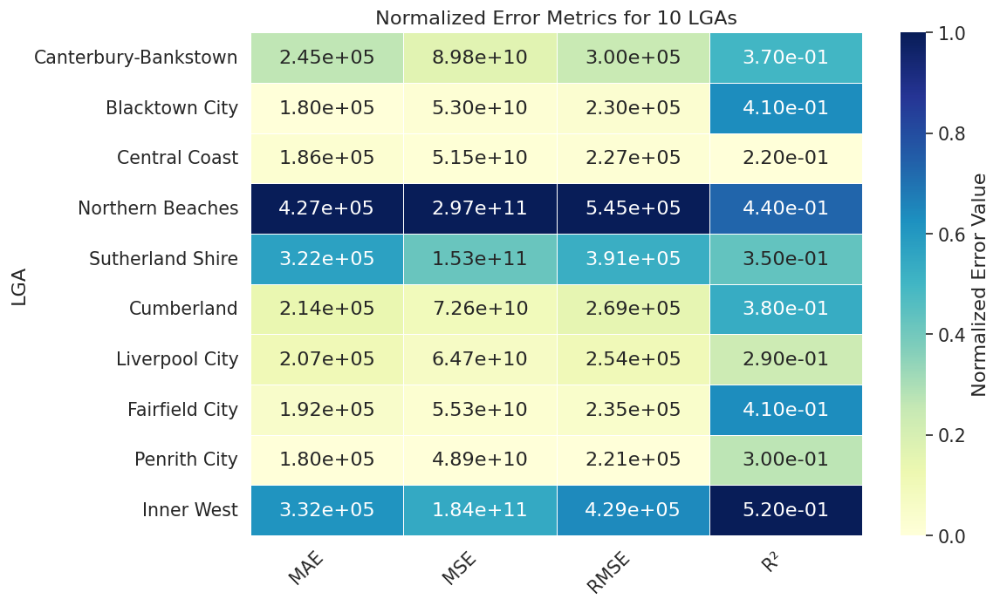

In [20]:
error_matrix_pivot = error_matrix.set_index('LGA')

numeric_columns = error_matrix_pivot.select_dtypes(include=[np.number])

error_matrix_normalized = numeric_columns.copy()
for column in error_matrix_normalized.columns:
    # Normalize each column to a range between 0 and 1
    min_val = error_matrix_normalized[column].min()
    max_val = error_matrix_normalized[column].max()
    error_matrix_normalized[column] = (error_matrix_normalized[column] - min_val) / (max_val - min_val)

# Create a larger figure to fit all the metrics
plt.figure(figsize=(10, 6))

# Create a heatmap with individual color scaling per column
sns.heatmap(
    error_matrix_normalized.astype(float),  # Use the normalized numeric data for color scaling
    annot=numeric_columns,  # Annotate with the original values
    cmap='YlGnBu',  # Color map for the heatmap
    fmt='.2e',  # Format the numbers in scientific notation with 2 decimals
    linewidths=0.5,  # Add grid lines for clarity
    cbar_kws={'label': 'Normalized Error Value'}  # Label for the color bar
)

# Rotate the y-axis labels for better visibility
plt.xticks(rotation=45, ha='right')

# Set a title for the heatmap
plt.title('Normalized Error Metrics for 10 LGAs')

# Show the heatmap
plt.tight_layout()
plt.show()

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


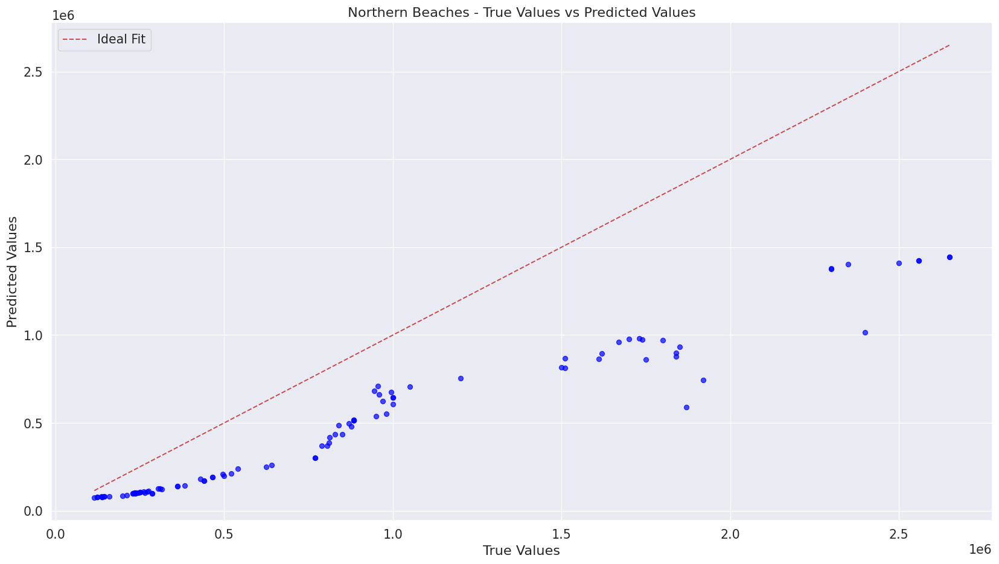

In [21]:
custom_labels = [
    'Canterbury-Bankstown',
    'Blacktown City',
    'Central Coast',
    'Northern Beaches',
    'Sutherland Shire',
    'Cumberland',
    'Liverpool City',
    'Fairfield City',
    'Penrith City',
    'Inner West'
]


# Suburb to graph
selected_suburb = 'Northern Beaches'

# Get the index of the selected suburb
suburb_index = custom_labels.index(selected_suburb)

# Assuming your model is trained and xtest and ytest are your test data

# Make predictions
predicted_values = model.predict(xtest)

# Convert ytest to a 2D array if it's not already
true = ytest.copy()
true = np.array(true)

# Ensure ytest and predicted_values are 2D
if ytest.ndim == 1:
    ytest = ytest.reshape(-1, num_outputs)

# Plotting the true values vs the predicted values for the selected suburb
plt.figure(figsize=(14, 8))
plt.scatter(true[:, suburb_index], predicted_values[:, suburb_index], alpha=0.7, color='blue')
plt.plot([true[:, suburb_index].min(), true[:, suburb_index].max()], [true[:, suburb_index].min(), true[:, suburb_index].max()], 'r--', label='Ideal Fit')
plt.title(f'{selected_suburb} - True Values vs Predicted Values')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

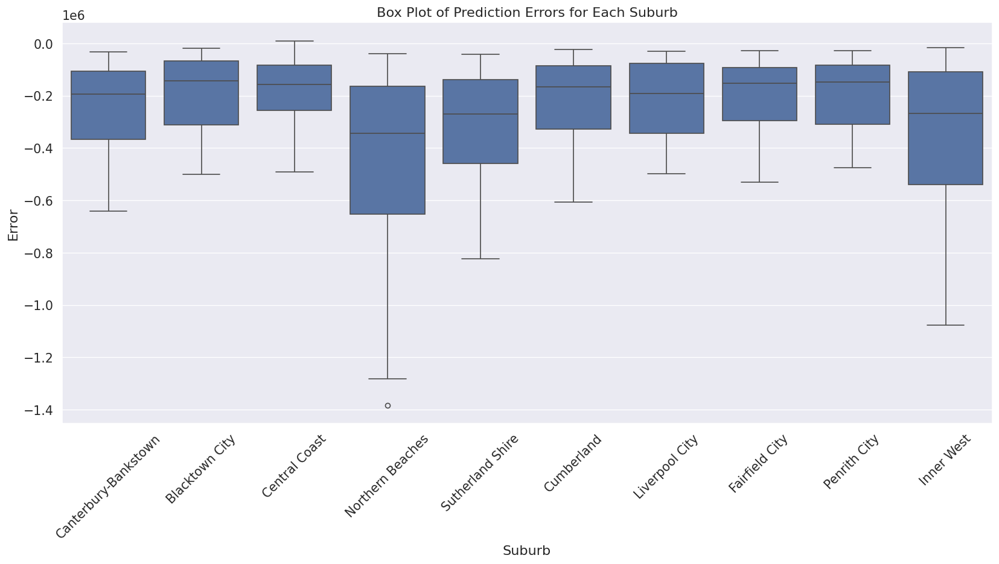

In [22]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

true_new = ytest.copy()
true_new.columns = custom_labels
errors = predicted_values - true_new
df_errors_melted = errors.melt(var_name='Suburb', value_name='Error')

# Plot box plot of errors
plt.figure(figsize=(14, 8))
sns.boxplot(x='Suburb', y='Error', data=df_errors_melted)
plt.title('Box Plot of Prediction Errors for Each Suburb')
plt.xlabel('Suburb')
plt.ylabel('Error')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

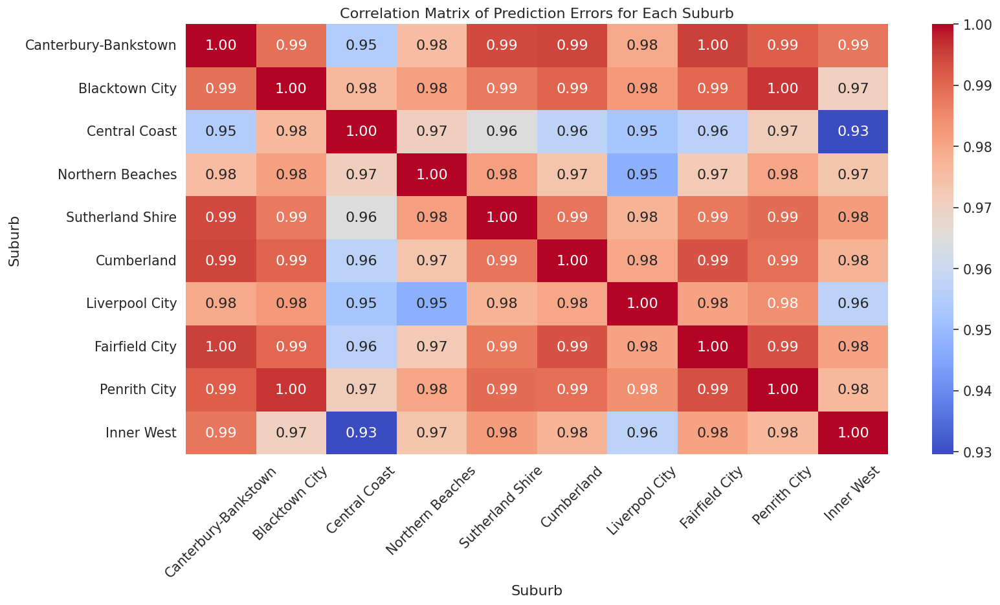

In [23]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Plot correlation matrix
plt.figure(figsize=(14, 8))
sns.heatmap(errors.corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of Prediction Errors for Each Suburb')
plt.xlabel('Suburb')
plt.ylabel('Suburb')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

<ipython-input-24-6d3d6d96ad53>:19: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_combined = pd.concat([df_pred_melted, df_true_melted])


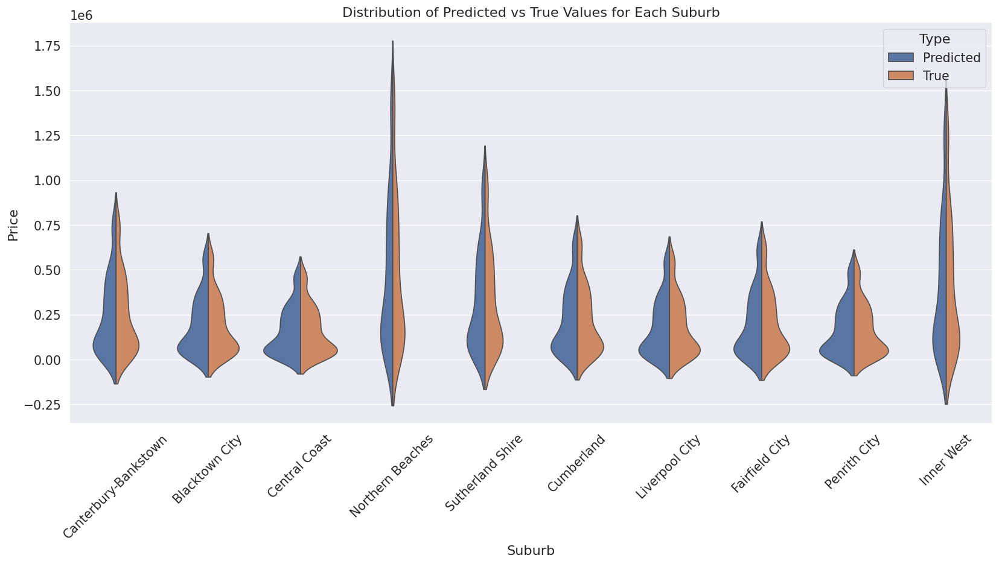

In [24]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

true = ytest.copy()

# Reshape data for violin plot
df_pred = pd.DataFrame(predicted_values, columns=custom_labels)
df_true = pd.DataFrame(true, columns=custom_labels)

# Melt dataframes for seaborn
df_pred_melted = df_pred.melt(var_name='Suburb', value_name='Value', col_level=0)
df_pred_melted['Type'] = 'Predicted'

df_true_melted = df_true.melt(var_name='Suburb', value_name='Value', col_level=0)
df_true_melted['Type'] = 'True'

# Combine dataframes
df_combined = pd.concat([df_pred_melted, df_true_melted])

# Plot violin plot without inner bars
plt.figure(figsize=(14, 8))
sns.violinplot(x='Suburb', y='Value', hue='Type', data=df_combined, split=True, inner=None)
plt.title('Distribution of Predicted vs True Values for Each Suburb')
plt.xlabel('Suburb')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Different Models

## Random Forest

In [25]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
RF = MultiOutputRegressor(RandomForestRegressor(criterion='squared_error'))
RF.fit(xtrain, ytrain)

MultiOutputRegressor(estimator=RandomForestRegressor())

In [26]:
RFP = RF.predict(xtest)

In [27]:
RFP_DF = pd.DataFrame(RFP, columns=labels)
RFP_DF

,CANTERBURY-BANKSTOWN COUNCIL(LGA) (House)_price,BLACKTOWN CITY COUNCIL (LGA) (House)_price,CENTRAL COAST COUNCIL(LGA) (House)_price,NORTHERN BEACHES COUNCIL(LGA) (House)_price,SUTHERLAND SHIRE COUNCIL (LGA) (House)_price,CUMBERLAND COUNCIL(LGA) (House)_price,LIVERPOOL CITY COUNCIL (LGA) (House)_price,FAIRFIELD CITY COUNCIL (LGA) (House)_price,PENRITH CITY COUNCIL (LGA) (House)_price,INNER WEST COUNCIL(LGA) (House)_price
0,1339400.0,1066500.0,924840.0,2605500.0,1710400.0,1218987.52,1026470.0,1058810.000,915070.0,2132415.0
1,84140.0,62170.0,62610.0,157320.0,113750.0,72537.50,66280.0,66785.950,63380.0,82511.0
2,184170.0,117310.0,130300.0,303650.0,236280.0,152495.50,121005.0,140830.000,125839.9,220437.5
3,157390.0,110670.0,103020.0,239620.0,200770.0,132213.02,105855.0,127104.000,113940.0,164942.5
4,156850.0,115160.0,116720.0,235650.0,198920.0,131795.88,106060.0,129918.500,111280.0,158735.0
...,...,...,...,...,...,...,...,...,...,...
91,186550.0,128230.0,135260.0,313300.0,243630.0,157068.00,113000.0,143630.000,126602.5,232659.0
92,105450.0,64800.0,46340.0,209260.0,143050.0,88415.00,66762.5,77355.625,69650.0,110748.5
93,464410.0,358580.0,361900.0,803110.0,590240.0,402037.50,407190.0,375945.000,342732.0,612182.5
94,457860.0,352140.0,340060.0,852210.0,606450.0,404954.00,392305.0,363225.000,340775.0,697417.5


In [28]:
ytest_DF = pd.DataFrame(ytest, columns=labels)

In [29]:
RF_metrics = []

# Calculate metrics for each LGA
for label in labels:
    y_true = ytest_DF[label]
    y_pred = RFP_DF[label]

    # Calculate metrics
    R2 = r2_score(y_true, y_pred)
    MAE = mean_absolute_error(y_true, y_pred)
    MSE = mean_squared_error(y_true, y_pred)
    RMSE = np.sqrt(MSE)

    # Append metrics to the list
    RF_metrics.append({
        'LGA': label,
        'R²': R2,
        'MAE': MAE,
        'MSE': MSE,
        'RMSE': RMSE
    })

# Create a DataFrame to display the metrics
metrics_df = pd.DataFrame(RF_metrics)
metrics_df['LGA'] = custom_labels
# Display the metrics DataFrame
metrics_df

,LGA,R²,MAE,MSE,RMSE
0,Canterbury-Bankstown,0.998730,6230.000000,1.816881e+08,13479.173982
1,Blacktown City,0.999207,4537.916667,7.096298e+07,8423.952828
2,Central Coast,0.998326,6042.500000,1.104876e+08,10511.306512
3,Northern Beaches,0.998568,12228.854167,7.565346e+08,27505.173320
4,Sutherland Shire,0.998512,8286.875000,3.499628e+08,18707.293809
5,Cumberland,0.999225,4757.762083,9.054246e+07,9515.380012
6,Liverpool City,0.999293,4164.145104,6.454654e+07,8034.085853
7,Fairfield City,0.999083,4217.529948,8.576138e+07,9260.743784
8,Penrith City,0.999606,2966.369167,2.760414e+07,5253.964525
9,Inner West,0.998113,11526.697917,7.200643e+08,26834.013588


In [30]:
RF_R2 = r2_score(ytest, RFP)
RF_MAE = mean_absolute_error(ytest, RFP)
RF_MSE = mean_squared_error(ytest, RFP)
RF_RMSE = np.sqrt(RF_MSE)

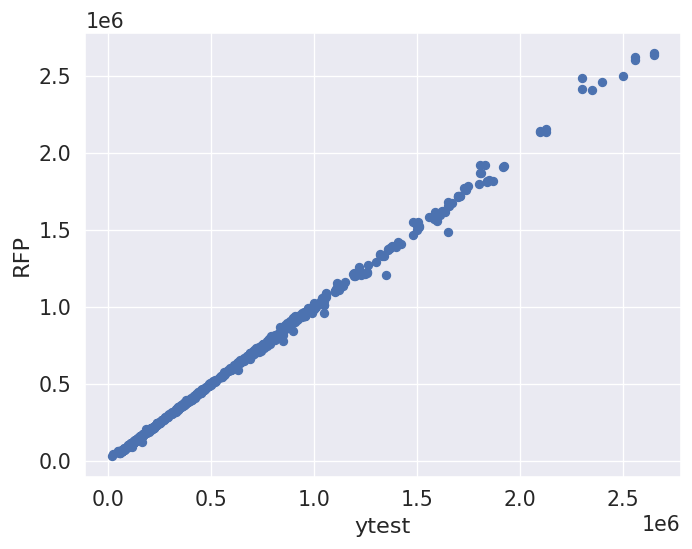

In [31]:
plt.scatter(ytest, RFP)
plt.xlabel('ytest')
plt.ylabel('RFP')
plt.show()

## SVM

In [32]:
from sklearn.svm import SVR

SVR = MultiOutputRegressor(SVR())
MSVR = make_pipeline(StandardScaler(), SVR)
MSVR.fit(xtrain, ytrain)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('multioutputregressor',
                 MultiOutputRegressor(estimator=SVR()))])

In [33]:
SVMP = MSVR.predict(xtest)

In [34]:
MSVR_R2 = r2_score(ytest, SVMP)
MSVR_MAE = mean_absolute_error(ytest, SVMP)
MSVR_MSE = mean_squared_error(ytest, SVMP)
MSVR_RMSE = np.sqrt(MSVR_MSE)

In [35]:
SVMP_DF = pd.DataFrame(SVMP, columns=labels)
SVMP_DF

,CANTERBURY-BANKSTOWN COUNCIL(LGA) (House)_price,BLACKTOWN CITY COUNCIL (LGA) (House)_price,CENTRAL COAST COUNCIL(LGA) (House)_price,NORTHERN BEACHES COUNCIL(LGA) (House)_price,SUTHERLAND SHIRE COUNCIL (LGA) (House)_price,CUMBERLAND COUNCIL(LGA) (House)_price,LIVERPOOL CITY COUNCIL (LGA) (House)_price,FAIRFIELD CITY COUNCIL (LGA) (House)_price,PENRITH CITY COUNCIL (LGA) (House)_price,INNER WEST COUNCIL(LGA) (House)_price
0,446009.748062,344988.065031,342521.635805,790039.083542,584987.990309,384997.618400,374986.847389,344113.615701,325397.918928,617496.058742
1,445927.921044,344906.137632,342443.384243,789954.881171,584905.259651,384916.454090,374907.440352,344033.222041,325316.065400,617412.347847
2,445921.379994,344896.944527,342437.178713,789943.343665,584896.612910,384910.056331,374903.221410,344027.076210,325308.902512,617403.021304
3,445929.209039,344906.352324,342444.052922,789953.134951,584904.662045,384917.657275,374909.737382,344034.376567,325316.834208,617411.456301
4,445935.097414,344913.127988,342449.714790,789960.187261,584911.622805,384923.776921,374915.378494,344040.869742,325322.942039,617418.025642
...,...,...,...,...,...,...,...,...,...,...
91,445920.799928,344897.872085,342435.891257,789943.738456,584896.434701,384909.586441,374901.766422,344027.206577,325308.553713,617402.552937
92,445921.095350,344899.053647,342437.772670,789947.213396,584898.516290,384909.800182,374901.454919,344026.428398,325309.063877,617404.855022
93,445982.527769,344959.919312,342495.223605,790002.836571,584953.693525,384971.060335,374963.026952,344088.170383,325370.330087,617461.738410
94,446012.355780,344993.282046,342521.277413,790044.271963,584992.934484,385000.549671,374989.384185,344118.377065,325400.998214,617500.329194


In [36]:
SVMP_metrics = []

# Calculate metrics for each LGA
for label in labels:
    y_true = ytest_DF[label]
    y_pred = SVMP_DF[label]

    # Calculate metrics
    R2 = r2_score(y_true, y_pred)
    MAE = mean_absolute_error(y_true, y_pred)
    MSE = mean_squared_error(y_true, y_pred)
    RMSE = np.sqrt(MSE)

    # Append metrics to the list
    SVMP_metrics.append({
        'LGA': label,
        'R²': R2,
        'MAE': MAE,
        'MSE': MSE,
        'RMSE': RMSE
    })

# Create a DataFrame to display the metrics
SVMP_metrics_df = pd.DataFrame(SVMP_metrics)
SVMP_metrics_df['LGA'] = custom_labels
# Display the metrics DataFrame
SVMP_metrics_df

,LGA,R²,MAE,MSE,RMSE
0,Canterbury-Bankstown,-0.019241,306354.760834,1.458421e+11,381892.744288
1,Blacktown City,-0.008928,240341.029406,9.023057e+10,300384.031598
2,Central Coast,0.000070,205739.793522,6.598458e+10,256874.647747
3,Northern Beaches,-0.025089,575484.236559,5.413851e+11,735788.757561
4,Sutherland Shire,-0.017291,392342.881880,2.393081e+11,489191.245017
5,Cumberland,-0.023637,274327.632879,1.195410e+11,345746.949715
6,Liverpool City,-0.002642,250402.747755,9.152898e+10,302537.562515
7,Fairfield City,-0.027897,246900.687296,9.608374e+10,309973.780538
8,Penrith City,-0.006701,215030.668591,7.044266e+10,265410.368717
9,Inner West,-0.040498,501910.215573,3.969670e+11,630053.204575


## Linear Regression Model

In [37]:
from sklearn.linear_model import LinearRegression
LR= MultiOutputRegressor(LinearRegression())
LR.fit(xtrain, ytrain)

MultiOutputRegressor(estimator=LinearRegression())

In [38]:
LRP = LR.predict(xtest)

In [39]:
LR_R2 = r2_score(ytest, LRP)
LR_MAE = mean_absolute_error(ytest, LRP)
LR_MSE = mean_squared_error(ytest, LRP)
LR_RMSE = np.sqrt(LR_MSE)

In [40]:
LR_DF = pd.DataFrame(LRP, columns=labels)
LR_DF

,CANTERBURY-BANKSTOWN COUNCIL(LGA) (House)_price,BLACKTOWN CITY COUNCIL (LGA) (House)_price,CENTRAL COAST COUNCIL(LGA) (House)_price,NORTHERN BEACHES COUNCIL(LGA) (House)_price,SUTHERLAND SHIRE COUNCIL (LGA) (House)_price,CUMBERLAND COUNCIL(LGA) (House)_price,LIVERPOOL CITY COUNCIL (LGA) (House)_price,FAIRFIELD CITY COUNCIL (LGA) (House)_price,PENRITH CITY COUNCIL (LGA) (House)_price,INNER WEST COUNCIL(LGA) (House)_price
0,1.298816e+06,1.041115e+06,920734.531368,2.511272e+06,1.656451e+06,1.150615e+06,1.002037e+06,1.052383e+06,908887.257711,2.032222e+06
1,6.020823e+04,4.459884e+04,48296.759404,1.414299e+05,9.325888e+04,4.664285e+04,3.649382e+04,5.059719e+04,50794.970788,5.617607e+04
2,2.180787e+05,1.542123e+05,166567.095039,3.704759e+05,2.995659e+05,1.870514e+05,1.635542e+05,1.674784e+05,151779.173927,2.710439e+05
3,1.432622e+05,1.075704e+05,124372.179337,1.999822e+05,1.798236e+05,1.250560e+05,1.216678e+05,1.224049e+05,109251.307158,1.561066e+05
4,1.345076e+05,9.255880e+04,58000.327179,1.756051e+05,1.466511e+05,1.148533e+05,8.375653e+04,1.132844e+05,91196.399678,1.382874e+05
...,...,...,...,...,...,...,...,...,...,...
91,1.699473e+05,1.075362e+05,91315.848373,2.786063e+05,2.247416e+05,1.491840e+05,1.042332e+05,1.340289e+05,116183.120375,2.212920e+05
92,7.526996e+04,4.067533e+04,70165.787790,1.450461e+05,1.126741e+05,6.143649e+04,5.377230e+04,4.879690e+04,48599.678074,6.588533e+04
93,4.588758e+05,3.417020e+05,356214.554441,8.028601e+05,6.045376e+05,3.937662e+05,3.870513e+05,3.594592e+05,322216.371877,6.362043e+05
94,4.665187e+05,3.575377e+05,340551.886640,8.595454e+05,6.230059e+05,4.062261e+05,3.888994e+05,3.640089e+05,331797.119886,7.221202e+05


In [41]:
LRP_metrics = []

# Calculate metrics for each LGA
for label in labels:
    y_true = ytest_DF[label]
    y_pred = LR_DF[label]

    # Calculate metrics
    R2 = r2_score(y_true, y_pred)
    MAE = mean_absolute_error(y_true, y_pred)
    MSE = mean_squared_error(y_true, y_pred)
    RMSE = np.sqrt(MSE)

    # Append metrics to the list
    LRP_metrics.append({
        'LGA': label,
        'R²': R2,
        'MAE': MAE,
        'MSE': MSE,
        'RMSE': RMSE
    })

# Create a DataFrame to display the metrics
LRP_metrics_df = pd.DataFrame(LRP_metrics)
LRP_metrics_df['LGA'] = custom_labels
# Display the metrics DataFrame
LRP_metrics_df

,LGA,R²,MAE,MSE,RMSE
0,Canterbury-Bankstown,0.988775,28454.639761,1.606119e+09,40076.419655
1,Blacktown City,0.991363,20073.167892,7.724156e+08,27792.366083
2,Central Coast,0.982678,26025.644691,1.143095e+09,33809.683854
3,Northern Beaches,0.986244,54837.001927,7.265271e+09,85236.558836
4,Sutherland Shire,0.989401,35245.904118,2.493199e+09,49931.940268
5,Cumberland,0.988965,26908.527091,1.288720e+09,35898.744221
6,Liverpool City,0.989414,22526.390549,9.663888e+08,31086.795028
7,Fairfield City,0.990055,22388.572404,9.296219e+08,30489.701155
8,Penrith City,0.992729,17037.147480,5.087770e+08,22556.085597
9,Inner West,0.986419,46123.078327,5.181365e+09,71981.699474


# Comparing Models

In [42]:
comparison_df = pd.DataFrame({
    'Model': ['Random Forest', 'Support Vector Regressor', 'Linear Regression', 'Neural Network'],
    'R²': [RF_R2, MSVR_R2, LR_R2, np.mean(error_matrix['R²'])],
    'MAE': [RF_MAE, MSVR_MAE, LR_MAE, np.mean(error_matrix['MAE'])],
    'MSE': [RF_MSE, MSVR_MSE, LR_MSE, np.mean(error_matrix['MSE'])],
    'RMSE': [RF_RMSE, MSVR_RMSE, LR_RMSE, np.mean(error_matrix['RMSE'])]
})

comparison_df

,Model,R²,MAE,MSE,RMSE
0,Random Forest,0.998866,6495.865005,2.458155e+08,15678.503992
1,Support Vector Regressor,-0.017185,320883.465429,1.857314e+11,430965.632992
2,Linear Regression,0.988604,29962.007424,2.215497e+09,47069.068360
3,Neural Network,0.369000,248498.673000,1.069015e+11,310121.328000


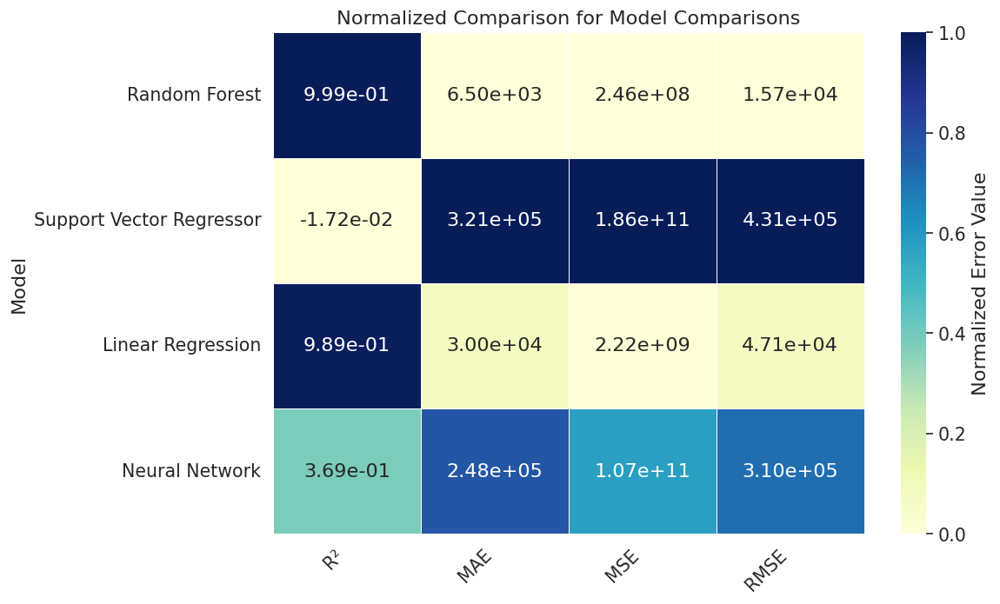

In [43]:
# Set the model names as the index
comparison_df_pivot = comparison_df.set_index('Model')

# Select only numeric columns for normalization
numeric_columns_comp = comparison_df_pivot.select_dtypes(include=[np.number])

# Normalize each numeric column to a range between 0 and 1
comparison_df_normalized = numeric_columns_comp.copy()
for column in comparison_df_normalized.columns:
    min_val = comparison_df_normalized[column].min()
    max_val = comparison_df_normalized[column].max()
    comparison_df_normalized[column] = (comparison_df_normalized[column] - min_val) / (max_val - min_val)

# Create a larger figure to fit all the metrics
plt.figure(figsize=(10, 6))

# Create a heatmap with individual color scaling per column
sns.heatmap(
    comparison_df_normalized.astype(float),  # Use the normalized numeric data for color scaling
    annot=numeric_columns_comp,  # Annotate with the original values
    cmap='YlGnBu',  # Color map for the heatmap
    fmt='.2e',  # Format the numbers in scientific notation with 2 decimals
    linewidths=0.5,  # Add grid lines for clarity
    cbar_kws={'label': 'Normalized Error Value'}  # Label for the color bar
)

# Rotate the x-axis labels for better visibility
plt.xticks(rotation=45, ha='right')

# Set a title for the heatmap
plt.title('Normalized Comparison for Model Comparisons')

# Show the heatmap
plt.tight_layout()
plt.show()

# New Neural Network

In [44]:
from keras.layers import LeakyReLU
sequence_length = xtrain.shape[0]  # Length of each input sequence
num_features = xtrain.shape[1]     # Number of features for each time step
num_outputs = 10                 # Number of output features

# Define the model
model2 = keras.Sequential([
    layers.Input(shape=(num_features,)),
    layers.Dense(128),
    LeakyReLU(negative_slope=0.1),
    layers.Dropout(0.2),
    layers.Dense(64),
    LeakyReLU(negative_slope=0.1),
    layers.Dropout(0.2),
    layers.Dense(32),
    LeakyReLU(negative_slope=0.1),
    layers.Dense(num_outputs)
])

In [45]:
optimizer = keras.optimizers.Adam(learning_rate=0.001, clipvalue=1.0)
model2.compile(optimizer=optimizer, loss='mean_squared_error')

In [46]:
!pip install tensorboard

In [47]:
import tensorflow as tf
from tensorflow.keras.callbacks import TensorBoard
import datetime

# Create a log directory for TensorBoard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

history = model2.fit(
    xtrain,
    ytrain,
    epochs=100,
    batch_size=32,
    validation_data=(xtest, ytest),
    callbacks=[tensorboard_callback]
)

Epoch 1/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 25ms/step - loss: 370482872320.0000 - val_loss: 212892647424.0000
Epoch 2/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 201329016832.0000 - val_loss: 134990790656.0000
Epoch 3/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 155142635520.0000 - val_loss: 134175358976.0000
Epoch 4/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 151715332096.0000 - val_loss: 130241142784.0000
Epoch 5/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 158298456064.0000 - val_loss: 133728804864.0000
Epoch 6/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 151753244672.0000 - val_loss: 126947663872.0000
Epoch 7/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 136689336320.0000 - val_loss: 126910914560.0000
Epoch 8/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 130760884224.0000 - val_loss: 125769736192.0000
Epoch 9/100
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 129726382080.0000 - val_loss: 122688741376.0000
Epoch 10/100
12/12 ━━━━━━━━━

In [48]:
%load_ext tensorboard
%tensorboard --logdir logs/fit

Output hidden; open in https://colab.research.google.com to view.

In [49]:
predicted_values_2 = model2.predict(xtest)

from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import pandas as pd

labels =  [
    'CANTERBURY-BANKSTOWN COUNCIL(LGA) (House)_price',
    'BLACKTOWN CITY COUNCIL (LGA) (House)_price',
    'CENTRAL COAST COUNCIL(LGA) (House)_price',
    'NORTHERN BEACHES COUNCIL(LGA) (House)_price',
    'SUTHERLAND SHIRE COUNCIL (LGA) (House)_price',
    'CUMBERLAND COUNCIL(LGA) (House)_price',
    'LIVERPOOL CITY COUNCIL (LGA) (House)_price',
    'FAIRFIELD CITY COUNCIL (LGA) (House)_price',
    'PENRITH CITY COUNCIL (LGA) (House)_price',
    'INNER WEST COUNCIL(LGA) (House)_price'
]

custom_labels = [
    'Canterbury-Bankstown',
    'Blacktown City',
    'Central Coast',
    'Northern Beaches',
    'Sutherland Shire',
    'Cumberland',
    'Liverpool City',
    'Fairfield City',
    'Penrith City',
    'Inner West'
]


# Error Metric Lists for each model
mae_list_2 = []
mse_list_2 = []
rmse_list_2 = []
r2_list_2 = []

# Loop over each LGA (each column of the predicted and true values)
for label in labels:
    # True values and predictions for the ith LGA
    y_true = ytest[label]
    y_pred = predicted_values_2[:, labels.index(label)]

    # Calculate error metrics
    mae = float(mean_absolute_error(y_true, y_pred))
    mse = float(mean_squared_error(y_true, y_pred))
    rmse = float(np.sqrt(mse))
    r2 = float(r2_score(y_true, y_pred))

    # Store the results
    mae_list_2.append(mae)
    mse_list_2.append(mse)
    rmse_list_2.append(rmse)
    r2_list_2.append(r2)

# Create a DataFrame to store the results as an error matrix
error_matrix_2 = pd.DataFrame({
    'LGA': custom_labels,
    'MAE': mae_list_2,
    'MSE': mse_list_2,
    'RMSE': rmse_list_2,
    'R²': r2_list_2
})

# Display the error matrix
error_matrix_2['MSE'] = error_matrix_2['MSE'].round(2)
error_matrix_2['MAE'] = error_matrix_2['MAE'].round(2)
error_matrix_2['RMSE'] = error_matrix_2['RMSE'].round(2)
error_matrix_2['R²'] = error_matrix_2['R²'].round(2)
error_matrix_2

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


,LGA,MAE,MSE,RMSE,R²
0,Canterbury-Bankstown,66793.26,9.020000e+09,94973.68,0.94
1,Blacktown City,50994.67,5.376184e+09,73322.47,0.94
2,Central Coast,46520.59,4.381504e+09,66192.93,0.93
3,Northern Beaches,133963.19,3.952892e+10,198818.81,0.93
4,Sutherland Shire,83049.81,1.267389e+10,112578.37,0.95
5,Cumberland,53710.22,6.311762e+09,79446.60,0.95
6,Liverpool City,45338.16,4.009482e+09,63320.47,0.96
7,Fairfield City,55345.64,6.072647e+09,77927.19,0.94
8,Penrith City,45112.50,4.091621e+09,63965.78,0.94
9,Inner West,113849.65,2.642450e+10,162556.15,0.93


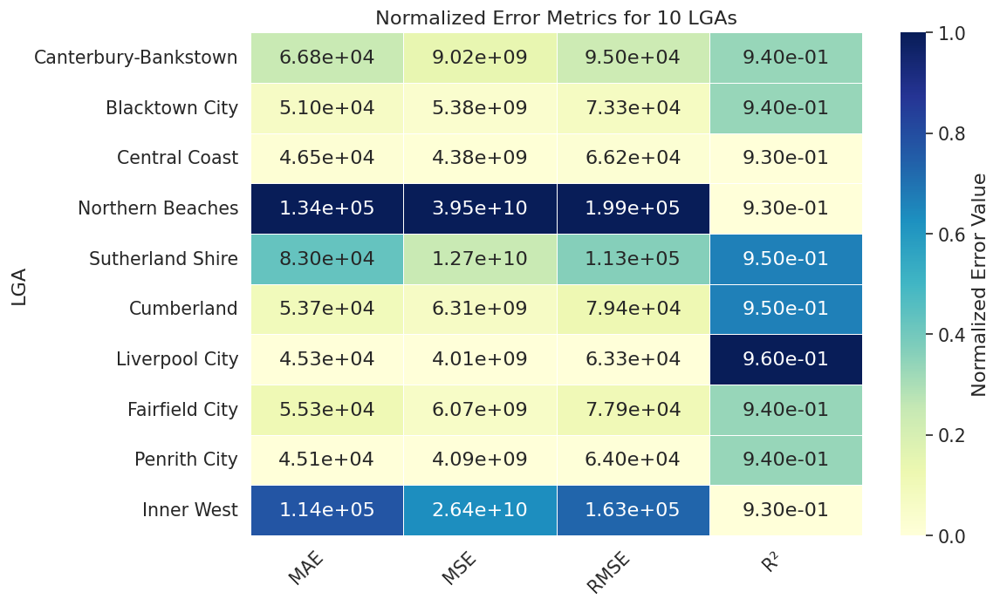

In [50]:
error_matrix_pivot_2 = error_matrix_2.set_index('LGA')

numeric_columns = error_matrix_pivot_2.select_dtypes(include=[np.number])

error_matrix_normalized_2 = numeric_columns.copy()
for column in error_matrix_normalized_2.columns:
    # Normalize each column to a range between 0 and 1
    min_val = error_matrix_normalized_2[column].min()
    max_val = error_matrix_normalized_2[column].max()
    error_matrix_normalized_2[column] = (error_matrix_normalized_2[column] - min_val) / (max_val - min_val)

# Create a larger figure to fit all the metrics
plt.figure(figsize=(10, 6))

# Create a heatmap with individual color scaling per column
sns.heatmap(
    error_matrix_normalized_2.astype(float),  # Use the normalized numeric data for color scaling
    annot=numeric_columns,  # Annotate with the original values
    cmap='YlGnBu',  # Color map for the heatmap
    fmt='.2e',  # Format the numbers in scientific notation with 2 decimals
    linewidths=0.5,  # Add grid lines for clarity
    cbar_kws={'label': 'Normalized Error Value'}  # Label for the color bar
)

# Rotate the y-axis labels for better visibility
plt.xticks(rotation=45, ha='right')

# Set a title for the heatmap
plt.title('Normalized Error Metrics for 10 LGAs')

# Show the heatmap
plt.tight_layout()
plt.show()

In [51]:
comparison_df = pd.DataFrame({
    'Model': ['Random Forest', 'Support Vector Regressor', 'Linear Regression', 'Neural Network', 'New Neural Network'],
    'R²': [RF_R2, MSVR_R2, LR_R2, np.mean(error_matrix['R²']), np.mean(error_matrix_2['R²'])],
    'MAE': [RF_MAE, MSVR_MAE, LR_MAE, np.mean(error_matrix['MAE']), np.mean(error_matrix_2['MAE'])],
    'MSE': [RF_MSE, MSVR_MSE, LR_MSE, np.mean(error_matrix['MSE']), np.mean(error_matrix_2['MSE'])],
    'RMSE': [RF_RMSE, MSVR_RMSE, LR_RMSE, np.mean(error_matrix['RMSE']), np.mean(error_matrix_2['RMSE'])]
})

comparison_df

,Model,R²,MAE,MSE,RMSE
0,Random Forest,0.998866,6495.865005,2.458155e+08,15678.503992
1,Support Vector Regressor,-0.017185,320883.465429,1.857314e+11,430965.632992
2,Linear Regression,0.988604,29962.007424,2.215497e+09,47069.068360
3,Neural Network,0.369000,248498.673000,1.069015e+11,310121.328000
4,New Neural Network,0.941000,69467.769000,1.178905e+10,99310.245000


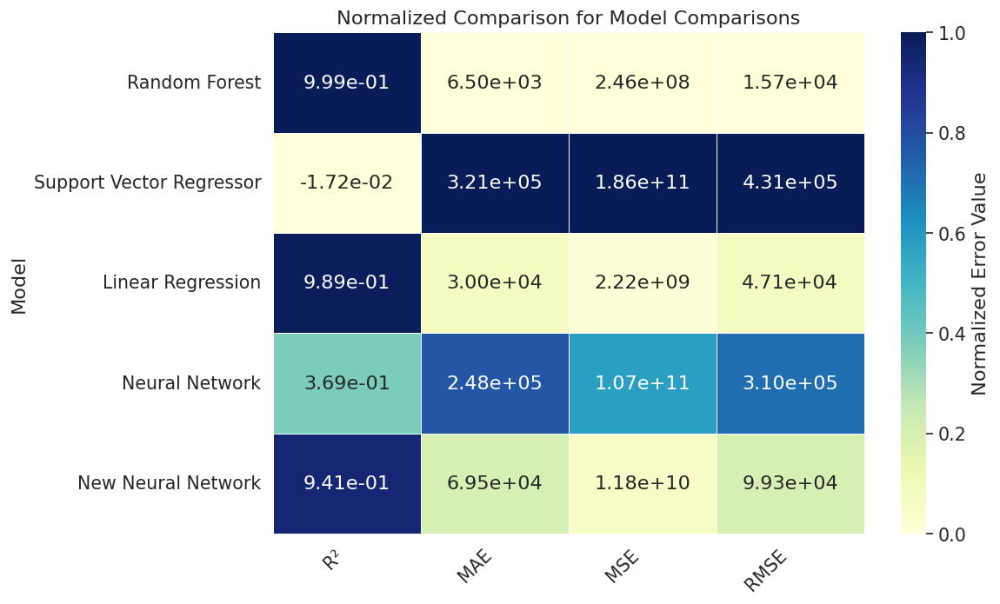

In [52]:
# Set the model names as the index
comparison_df_pivot = comparison_df.set_index('Model')

# Select only numeric columns for normalization
numeric_columns_comp = comparison_df_pivot.select_dtypes(include=[np.number])

# Normalize each numeric column to a range between 0 and 1
comparison_df_normalized = numeric_columns_comp.copy()
for column in comparison_df_normalized.columns:
    min_val = comparison_df_normalized[column].min()
    max_val = comparison_df_normalized[column].max()
    comparison_df_normalized[column] = (comparison_df_normalized[column] - min_val) / (max_val - min_val)

# Create a larger figure to fit all the metrics
plt.figure(figsize=(10, 6))

# Create a heatmap with individual color scaling per column
sns.heatmap(
    comparison_df_normalized.astype(float),  # Use the normalized numeric data for color scaling
    annot=numeric_columns_comp,  # Annotate with the original values
    cmap='YlGnBu',  # Color map for the heatmap
    fmt='.2e',  # Format the numbers in scientific notation with 2 decimals
    linewidths=0.5,  # Add grid lines for clarity
    cbar_kws={'label': 'Normalized Error Value'}  # Label for the color bar
)

# Rotate the x-axis labels for better visibility
plt.xticks(rotation=45, ha='right')

# Set a title for the heatmap
plt.title('Normalized Comparison for Model Comparisons')

# Show the heatmap
plt.tight_layout()
plt.show()

# Model Save

In [53]:
model.save('/content/gdrive/MyDrive/Year 3 Uni/31005 ML/first_nn.keras')
model2.save('/content/gdrive/MyDrive/Year 3 Uni/31005 ML/second_nn.keras')